<a href="https://colab.research.google.com/github/Baheejmk/Coursera_Capstone.-/blob/main/Battle_of_Neighbourhoods_Italian_Restuarant_in_NewYork.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

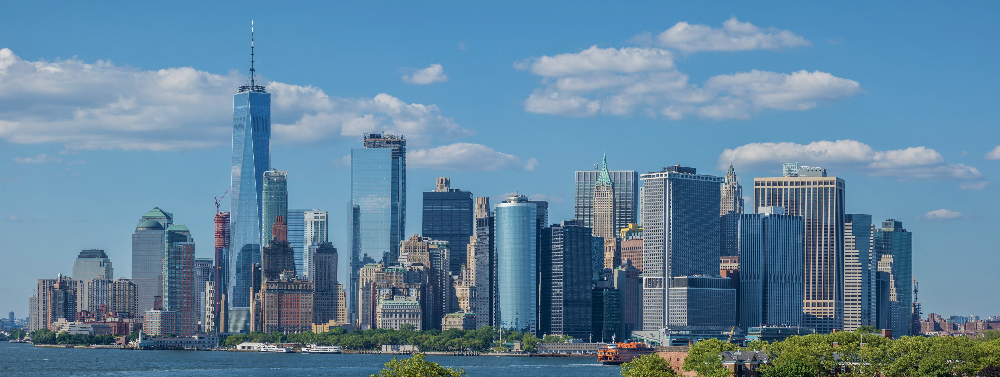


# **Battle of Neighborhoods**
## **1. Introduction**

 **1.1 Background**
 
New York is a major central city for diversity since many people from different cultural atmospheres have brought their families and dreams to New York City. The city has consistently seen people from around the world move to the city and call it home. It has been a center for trade and economic growth. New York is known world wide as a cultural melting pot. While other states have had immigration surges, none have compared to the diversity and sheer number of immigrants that have made their way to the City. So these number of varies cultures combined to create a great diversity for itself. Since People from all over the world tend to come up here, we can see some many of their cultural aspects Transport, Food, Clothing, and so on...

**1.2 Problem**

The objective of this project is to find the best neighbourhood in New York to open a Italian restaurant using Foursquare location data. In this project we’ll go through the solution for this problem for avoiding or considering low risk criteria and high success rate.

**1.3** **Interest**

The main interest of the Business to be started as an Italian restaurant would be to know about the many criteria that leads to come to a data driven conclusion for selecting the best neighborhood for opening one. But some of the criteria we are gonna be focusing on in our project is as follows,

1.Best Neighborhood for opening Italian Restaurant  in New York.

2.Area which lack Italian Restaurants.

3.Areas with Potential Italian Restaurants.

**1.4 Target Audiance**

1. Business personnel who wants to invest or open a restaurant.

2. The freelancer who loves to have their own restaurant as a side business.

3. Tourists who wants to eat Italian food.

# **Data Description**
**2.1 Data Sources**

Since we will be focusing on New York for opening our restaurant, we will be gathering the data for the same and the three main data we are gonna use are the New York Neighborhood data which we already used in the Neighborhoods in New York and the data about the cuisines in New York and the Geo spacial data of boundaries of the Neighborhoods in New York.

**2.1.1 Data 1:**

New York Neighborhood Data which will be used to get to know about the various neighborhoods which are gonna take into consideration for our Project.


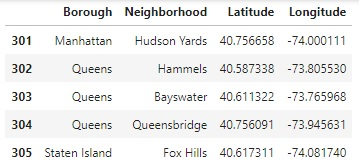


**2.1.2 Data 2:**

Geo-spacial data of the New York to get a better understanding of the neighborhoods in it and their corresponding locations in the Folium map would make certain things clear for the Project. This will be achieved using the acquired data and visualize the same using Choropleth maps.


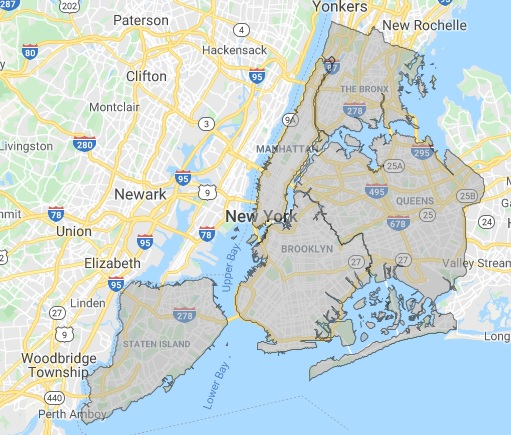
---



**2.1.3 Data 3:**

Finally the data going to be collected/acquired from the Foursquare API about the various restaurants in each neighborhood of New York city especially Italian cuisine, which will be used for acquiring the information regarding same for all the venues of each neighborhood.



## **2.2 Data Cleaning and approach**

Acquire the data from the various sources as mentioned below,

* New York neighborhood data from https://cocl.us/new_york_dataset
* Borough Boundaries data from https://data.cityofnewyork.us/City-Government/Borough-Boundaries/tqmj-j8zm
*Italian Cuisine related data from Foursquare



Filter the data for the required data acquired from Foursqaure which is only about Italian Cuisine.
Acquire the tips and from that get the rating of every restaurant in the neighborhood of New York.
Visualize the findings using Matplot lib and Folium for better understanding.

# **3. Data Analysis**

In [ ]:
import numpy as np 

import pandas as pd 
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json 

!conda install -c conda-forge geopy --yes 
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

from bs4 import BeautifulSoup
import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors
import matplotlib.pyplot as plt 

# import k-means from clustering stage
from sklearn.cluster import KMeans

!conda install -c conda-forge folium=0.5.0 --yes
import folium # map rendering library

print('Libraries imported.')

/bin/bash: conda: command not found
/bin/bash: conda: command not found
Libraries imported.


Define function to create a data set about New York from the acquired data.

In [ ]:
def get_new_york_data():
    url='https://cocl.us/new_york_dataset'
    resp=requests.get(url).json()
    # all data is present in features label
    features=resp['features']
    
    # define the dataframe columns
    column_names = ['Borough', 'Neighborhood', 'Latitude', 'Longitude'] 
    # instantiate the dataframe
    new_york_data = pd.DataFrame(columns=column_names)
    
    for data in features:
        borough = data['properties']['borough'] 
        neighborhood_name = data['properties']['name']
        
        neighborhood_latlon = data['geometry']['coordinates']
        neighborhood_lat = neighborhood_latlon[1]
        neighborhood_lon = neighborhood_latlon[0]
    
        new_york_data = new_york_data.append({'Borough': borough,
                                          'Neighborhood': neighborhood_name,
                                          'Latitude': neighborhood_lat,
                                          'Longitude': neighborhood_lon}, ignore_index=True)
    
    return new_york_data

In [ ]:

df_ny = get_new_york_data()
df_ny.head()

,Borough,Neighborhood,Latitude,Longitude
0,Bronx,Wakefield,40.894705,-73.847201
1,Bronx,Co-op City,40.874294,-73.829939
2,Bronx,Eastchester,40.887556,-73.827806
3,Bronx,Fieldston,40.895437,-73.905643
4,Bronx,Riverdale,40.890834,-73.912585


In [ ]:
df_ny[df_ny['Neighborhood']=='Woodlawn']

,Borough,Neighborhood,Latitude,Longitude
7,Bronx,Woodlawn,40.898273,-73.867315


Let's Create a Bar Chart

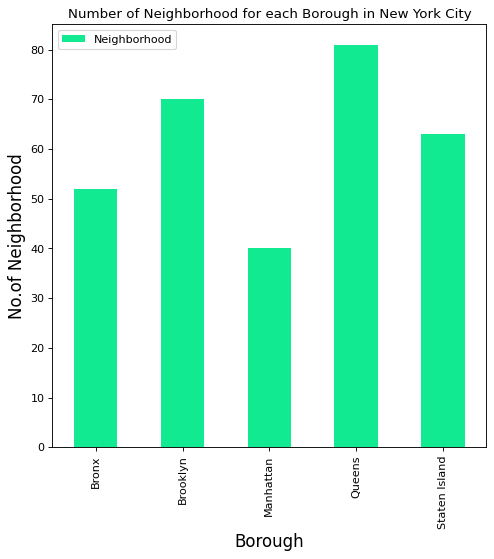

In [ ]:

plt.figure(figsize=(7,7), dpi = 80)
# title
plt.title('Number of Neighborhood for each Borough in New York City')
#On x-axis
plt.xlabel('Borough', fontsize = 15)
#On y-axis
plt.ylabel('No.of Neighborhood', fontsize=15)
#giving a bar plot
df_ny.groupby('Borough')['Neighborhood'].count().plot(kind='bar', color='#12EA92')
#legend
plt.legend()
#displays the plot
plt.show()

Define function for acquiring the latitude and longitude from the provided location

In [ ]:

def geo_location(address):
    # get geo location of address
    geolocator = Nominatim(user_agent="ny_explorer")
    location = geolocator.geocode(address)
    latitude = location.latitude
    longitude = location.longitude
    return latitude,longitude

Define a function to get the details of the venue by accessing the Foursquare API

In [ ]:
import os

In [ ]:
def get_venues(lat,lng):
    
    #set variables
    radius=1000
    LIMIT=100
    CLIENT_ID = 'OTF5Z4URDVBLMHSNQHKOW1ABSWPD0G2UKPDVF10UUUDFPBG4' # your Foursquare ID
    CLIENT_SECRET = 'R5AGMM1XZ4QYR214ZIFIXUEJ0MJCFXBHRGCAATVEF0KET0SI' # your Foursquare Secret
    VERSION = '20180605' # Foursquare API version
    
    #url to fetch data from foursquare api
    url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
    
    # get all the data
    results = requests.get(url).json()
    venue_data=results["response"]['groups'][0]['items']
    venue_details=[]
    for row in venue_data:
        try:
            venue_id=row['venue']['id']
            venue_name=row['venue']['name']
            venue_category=row['venue']['categories'][0]['name']
            venue_details.append([venue_id,venue_name,venue_category])
        except KeyError:
            pass
        
    column_names=['ID','Name','Category']
    df = pd.DataFrame(venue_details,columns=column_names)
    return df

def get_venue_details(venue_id):
        
    CLIENT_ID = 'OTF5Z4URDVBLMHSNQHKOW1ABSWPD0G2UKPDVF10UUUDFPBG4' # your Foursquare ID
    CLIENT_SECRET = 'R5AGMM1XZ4QYR214ZIFIXUEJ0MJCFXBHRGCAATVEF0KET0SI' # your Foursquare Secret
    VERSION = '20180605' # Foursquare API version
    
    #url to fetch data from foursquare api
    url = 'https://api.foursquare.com/v2/venues/{}?&client_id={}&client_secret={}&v={}'.format(
            venue_id,
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION)
    
    # get all the data
    results = requests.get(url).json()
    venue_data=results['response']['venue']
    venue_details=[]
    try:
        venue_id=venue_data['id']
        venue_name=venue_data['name']
        venue_likes=venue_data['likes']['count']
        venue_rating=venue_data['rating']
        venue_tips=venue_data['tips']['count']
        venue_details.append([venue_id,venue_name,venue_likes,venue_rating,venue_tips])
    except KeyError:
        pass
        
    column_names=['ID','Name','Likes','Rating','Tips']
    df = pd.DataFrame(venue_details,columns=column_names)
    return df

Get a list of each and every Italian Cuisine in the New York

In [ ]:
vns = get_venues(40.898273,-73.867315)
vns[vns['Category']=='Italian Restaurant']

,ID,Name,Category
2,511edb6de4b0d58346fd272d,Patrizia's Of Woodlawn,Italian Restaurant


In [ ]:

itlnres = vns[vns['Category']=='Italian Restaurant'].values.tolist()
itlnres

[['511edb6de4b0d58346fd272d', "Patrizia's Of Woodlawn", 'Italian Restaurant']]

In [ ]:

len(vns[vns['Category']=='Italian Restaurant'].values.tolist()) > 0

True

In [ ]:

for row in df_ny.values.tolist():
    print(row)

['Bronx', 'Wakefield', 40.89470517661, -73.84720052054902]
['Bronx', 'Co-op City', 40.87429419303012, -73.82993910812398]
['Bronx', 'Eastchester', 40.887555677350775, -73.82780644716412]
['Bronx', 'Fieldston', 40.89543742690383, -73.90564259591682]
['Bronx', 'Riverdale', 40.890834493891305, -73.9125854610857]
['Bronx', 'Kingsbridge', 40.88168737120521, -73.90281798724604]
['Manhattan', 'Marble Hill', 40.87655077879964, -73.91065965862981]
['Bronx', 'Woodlawn', 40.89827261213805, -73.86731496814176]
['Bronx', 'Norwood', 40.87722415599446, -73.8793907395681]
['Bronx', 'Williamsbridge', 40.88103887819211, -73.85744642974207]
['Bronx', 'Baychester', 40.866858107252696, -73.83579759808117]
['Bronx', 'Pelham Parkway', 40.85741349808865, -73.85475564017999]
['Bronx', 'City Island', 40.84724670491813, -73.78648845267413]
['Bronx', 'Bedford Park', 40.870185164975325, -73.8855121841913]
['Bronx', 'University Heights', 40.85572707719664, -73.9104159619131]
['Bronx', 'Morris Heights', 40.847897926

In [ ]:
# prepare neighborhood list that contains italian resturants
column_names=['Borough', 'Neighborhood', 'ID','Name','Latitude','Longitude']
italian_rest_ny=pd.DataFrame(columns=column_names)

print('Italian restaurants in\n---------------------')
       
for row in df_ny.values.tolist():
    Borough, Neighborhood, Latitude, Longitude=row
    venues = get_venues(Latitude,Longitude)
    italian_resturants=venues[venues['Category']=='Italian Restaurant']
    if len(italian_resturants) > 0:
        print(Neighborhood+', '+Borough+' : '+str(len(italian_resturants)))
    for resturant_detail in italian_resturants.values.tolist():
        id, name , category=resturant_detail
        italian_rest_ny = italian_rest_ny.append({'Borough': Borough,
                                                'Neighborhood': Neighborhood, 
                                                'ID': id,
                                                'Name' : name,
                                                'Latitude' : Latitude,
                                                'Longitude' : Longitude
                                               }, ignore_index=True)

print('Completed constructing the Italian cuisine restaurants data set')

Italian restaurants in
---------------------
Woodlawn, Bronx : 1
Baychester, Bronx : 2
Pelham Parkway, Bronx : 3
City Island, Bronx : 3
Bedford Park, Bronx : 1
Fordham, Bronx : 10
Melrose, Bronx : 2
Mott Haven, Bronx : 1
Morrisania, Bronx : 1
Throgs Neck, Bronx : 4
Country Club, Bronx : 3
Van Nest, Bronx : 2
Morris Park, Bronx : 4
Belmont, Bronx : 13
North Riverdale, Bronx : 2
Pelham Bay, Bronx : 3
Schuylerville, Bronx : 3
Edgewater Park, Bronx : 4
Pelham Gardens, Bronx : 1
Bay Ridge, Brooklyn : 5
Bensonhurst, Brooklyn : 3
Sunset Park, Brooklyn : 1
Greenpoint, Brooklyn : 4
Gravesend, Brooklyn : 1
Sheepshead Bay, Brooklyn : 4
Flatbush, Brooklyn : 1
Windsor Terrace, Brooklyn : 5
Prospect Heights, Brooklyn : 2
Williamsburg, Brooklyn : 1
Bushwick, Brooklyn : 2
Bedford Stuyvesant, Brooklyn : 1
Brooklyn Heights, Brooklyn : 4
Cobble Hill, Brooklyn : 6
Carroll Gardens, Brooklyn : 6
Gowanus, Brooklyn : 4
Fort Greene, Brooklyn : 6
Park Slope, Brooklyn : 3
Starrett City, Brooklyn : 1
Manhattan Be

In [ ]:

italian_rest_ny.head()

,Borough,Neighborhood,ID,Name,Latitude,Longitude
0,Bronx,Woodlawn,511edb6de4b0d58346fd272d,Patrizia's Of Woodlawn,40.898273,-73.867315
1,Bronx,Baychester,4c9518076b35a143d5dc21dc,Fratelli's,40.866858,-73.835798
2,Bronx,Baychester,5411894d498e4a254a11a46c,Olive Garden,40.866858,-73.835798
3,Bronx,Pelham Parkway,4bf96ae65317a593d837017f,Enzo's,40.857413,-73.854756
4,Bronx,Pelham Parkway,4b10591af964a5205f6e23e3,Patricia's,40.857413,-73.854756


In [ ]:
italian_rest_ny.shape

(501, 6)

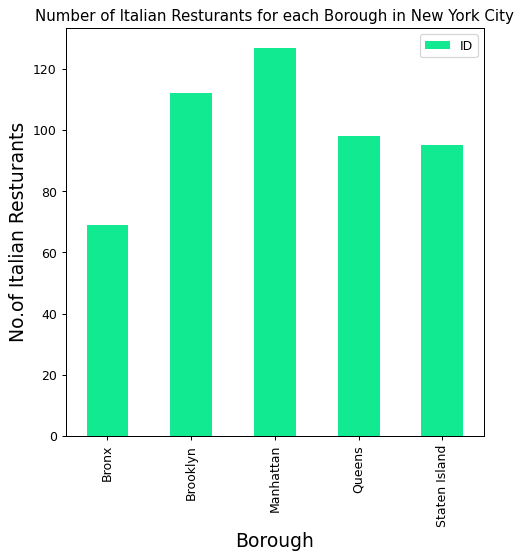

In [ ]:
plt.figure(figsize=(6,6), dpi = 90)
# title
plt.title('Number of Italian Resturants for each Borough in New York City')
#On x-axis
plt.xlabel('Borough', fontsize = 15)
#On y-axis
plt.ylabel('No.of Italian Resturants', fontsize=15)
#giving a bar plot
italian_rest_ny.groupby('Borough')['ID'].count().plot(kind='bar', color='#12EA92')
#legend
plt.legend()
#displays the plot
plt.show()

Let's Visualize Top 10 Neighbourhoods Based on Restaurants serving Italian Cuisine

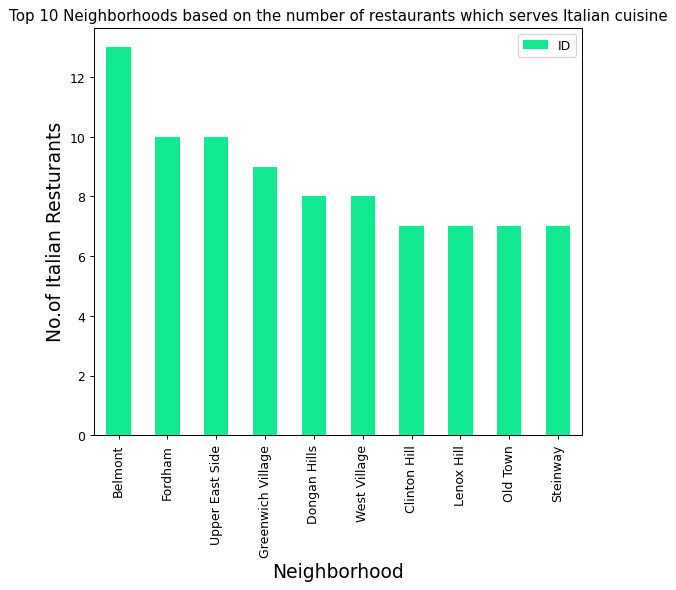

In [ ]:
plt.figure(figsize=(7,6), dpi = 90)
# title
plt.title('Top 10 Neighborhoods based on the number of restaurants which serves Italian cuisine')
#On x-axis
plt.xlabel('Neighborhood', fontsize = 15)
#On y-axis
plt.ylabel('No.of Italian Resturants', fontsize=15)
#giving a bar plot
italian_rest_ny.groupby('Neighborhood')['ID'].count().nlargest(10).plot(kind='bar', color='#12EA92')
#legend
plt.legend()
#displays the plot
plt.show()

So **Belmont** has the most number of Restuarants serving Italian Cuisine

In [ ]:
italian_rest_ny[italian_rest_ny['Neighborhood']=='Belmont']

,Borough,Neighborhood,ID,Name,Latitude,Longitude
37,Bronx,Belmont,4acf80aef964a52025d420e3,Tino's Delicatessen,40.857277,-73.888452
38,Bronx,Belmont,4bb6470cef159c7465b275f7,Calabria Pork Store,40.857277,-73.888452
39,Bronx,Belmont,59050f51b23dfa5f6649e678,Arthur Avenue Fiasco,40.857277,-73.888452
40,Bronx,Belmont,4af0fa29f964a52060e021e3,Antonio's Trattoria,40.857277,-73.888452
41,Bronx,Belmont,4b5514c4f964a5207cda27e3,Enzo's,40.857277,-73.888452
42,Bronx,Belmont,4aa425bef964a5208e4520e3,Dominick's Restaurant,40.857277,-73.888452
43,Bronx,Belmont,4b5a4c8ff964a52049bb28e3,Emilia's Restaurant,40.857277,-73.888452
44,Bronx,Belmont,4aa193d5f964a520124120e3,Mario's Restaurant & Catering,40.857277,-73.888452
45,Bronx,Belmont,4a8e261cf964a5201c1220e3,Roberto's,40.857277,-73.888452
46,Bronx,Belmont,4af71916f964a520cf0522e3,Michaelangelo's Coal Fired Brick Oven Pizza Re...,40.857277,-73.888452


Lets Visualize New York City

1.   First lets download Population data
2.   Then the Geojson file of Newyork for Chloropeth Map




In [ ]:
dfny = pd.read_csv('https://raw.githubusercontent.com/Baheejmk/Coursera_Capstone.-/main/NewyorkPopulation.csv', sep=',')

In [ ]:
dfny.head()

,Borough,Population
0,Manhattan,"1,628,706"
1,Brooklyn,"2,559,903"
2,Staten Island,"476,143"
3,Queens,2253858
4,Bronx,"1,418,207"


In [ ]:
dfny.columns = list(map(str, dfny.columns))
dfny.dtypes

Borough       object
Population    object
dtype: object

In [ ]:
dfny["Population"] = [float(str(i).replace(",", "")) for i in dfny["Population"]]
dfny.dtypes

Borough        object
Population    float64
dtype: object

In [ ]:
!wget --quiet https://raw.githubusercontent.com/Baheejmk/Coursera_Capstone.-/main/boroughs.geojson


In [ ]:

newyork = r'boroughs.geojson'
nymap = folium.Map(location=[40.7127281, -74.0060152],)
folium.GeoJson(newyork).add_to(nymap)
nymap







In [ ]:
folium.Choropleth(
    geo_data=newyork,
    data=dfny,
    columns=["Borough","Population"],
    key_on="feature.properties.BoroName",
    fill_color="YlGnBu",
    fill_opacity=0.9,
    line_opacity=0.2,
    legend_name="Population Rate (%)",
    highlight=True
).add_to(nymap)

nymap

In [ ]:
from folium import plugins
incidents = plugins.MarkerCluster().add_to(nymap)

for lat, lng, label, in zip(italian_rest_ny.Latitude, italian_rest_ny.Longitude, italian_rest_ny.Name):

    folium.Marker(
        location=[lat, lng],
        icon=None,
        popup=label,
    ).add_to(incidents)
           
nymap

We now has visualized NewYork City where in which italian restaurants are situated.

In [ ]:
#saving the map
nymap.save('italianrestaurantsinNY.html')

# **4. Conclusion**

Based on the Data Analysis and Visualization using Folium and Matplotlib we have rendered various bar charts and two maps from which we can come to a better understanding of the interests we had earlier to be discovered which are specified as follows.

1.   We found Manhatten Borough has the most Italian Restaurant.
2.   Belmont in Bronx has the most Italian Restaurant as a Neighbourhood.
3.   According to Census 2020 population data Staten Island has the lowest   population.
4. Bronx and Staten Island has the Lowest number of Italian Restaurants
5. Brooklyn is the most populated Borough in New York and Italian Restaurants in Brooklyn are low compared to Manhatten. So any Neighborhood in Brooklyn is a good choice to open an Italian Restaurant. 


